# Import Dependancies

In [3]:
# To enable plotting graphs in notebook
%matplotlib inline

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from scipy.stats import zscore

# Data loading, Preprocessing & EDA

In [4]:
# Load the dataset
bc_df = pd.read_csv("wisc_bc_data.csv")
bc_df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,points_worst,symmetry_worst,dimension_worst
0,87139402,B,12.32,12.39,78.85,464.1,0.10280,0.06981,0.03987,0.03700,...,13.50,15.64,86.97,549.1,0.1385,0.1266,0.12420,0.09391,0.2827,0.06771
1,8910251,B,10.60,18.95,69.28,346.4,0.09688,0.11470,0.06387,0.02642,...,11.88,22.94,78.28,424.8,0.1213,0.2515,0.19160,0.07926,0.2940,0.07587
2,905520,B,11.04,16.83,70.92,373.2,0.10770,0.07804,0.03046,0.02480,...,12.41,26.44,79.93,471.4,0.1369,0.1482,0.10670,0.07431,0.2998,0.07881
3,868871,B,11.28,13.39,73.00,384.8,0.11640,0.11360,0.04635,0.04796,...,11.92,15.77,76.53,434.0,0.1367,0.1822,0.08669,0.08611,0.2102,0.06784
4,9012568,B,15.19,13.21,97.65,711.8,0.07963,0.06934,0.03393,0.02657,...,16.20,15.73,104.50,819.1,0.1126,0.1737,0.13620,0.08178,0.2487,0.06766


In [5]:
# Initial data exploration
print("Dataset Shape:", bc_df.shape)
print("Dataset Types:\n", bc_df.dtypes)
print("Dataset Head:\n", bc_df.head())
print("Class Distribution:\n", bc_df['diagnosis'].value_counts())

Dataset Shape: (569, 32)
Dataset Types:
 id                     int64
diagnosis             object
radius_mean          float64
texture_mean         float64
perimeter_mean       float64
area_mean            float64
smoothness_mean      float64
compactness_mean     float64
concavity_mean       float64
points_mean          float64
symmetry_mean        float64
dimension_mean       float64
radius_se            float64
texture_se           float64
perimeter_se         float64
area_se              float64
smoothness_se        float64
compactness_se       float64
concavity_se         float64
points_se            float64
symmetry_se          float64
dimension_se         float64
radius_worst         float64
texture_worst        float64
perimeter_worst      float64
area_worst           float64
smoothness_worst     float64
compactness_worst    float64
concavity_worst      float64
points_worst         float64
symmetry_worst       float64
dimension_worst      float64
dtype: object
Dataset Head:
   

In [6]:
# Convert 'diagnosis' to categorical
bc_df['diagnosis'] = bc_df['diagnosis'].astype('category')

In [7]:
# Drop the 'id' column as it is not useful for modeling
bc_df = bc_df.drop(columns='id')
print("Dataset Shape after dropping 'id' column:", bc_df.shape)

Dataset Shape after dropping 'id' column: (569, 31)


In [8]:
# Descriptive statistics
print("Dataset Description:\n", bc_df.describe().transpose())

Dataset Description:
                    count        mean         std         min         25%  \
radius_mean        569.0   14.127292    3.524049    6.981000   11.700000   
texture_mean       569.0   19.289649    4.301036    9.710000   16.170000   
perimeter_mean     569.0   91.969033   24.298981   43.790000   75.170000   
area_mean          569.0  654.889104  351.914129  143.500000  420.300000   
smoothness_mean    569.0    0.096360    0.014064    0.052630    0.086370   
compactness_mean   569.0    0.104341    0.052813    0.019380    0.064920   
concavity_mean     569.0    0.088799    0.079720    0.000000    0.029560   
points_mean        569.0    0.048919    0.038803    0.000000    0.020310   
symmetry_mean      569.0    0.181162    0.027414    0.106000    0.161900   
dimension_mean     569.0    0.062798    0.007060    0.049960    0.057700   
radius_se          569.0    0.405172    0.277313    0.111500    0.232400   
texture_se         569.0    1.216853    0.551648    0.360200    0.

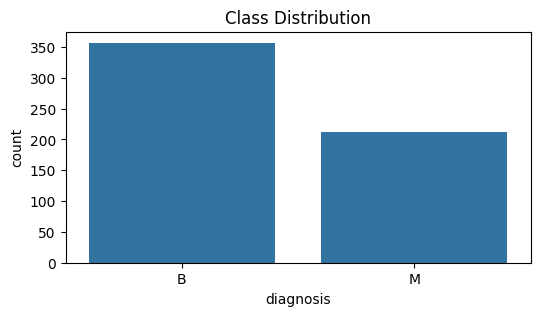

In [9]:
# Visualize class distribution
plt.figure(figsize=(6, 3))
sns.countplot(x='diagnosis', data=bc_df)
plt.title("Class Distribution")
plt.show()

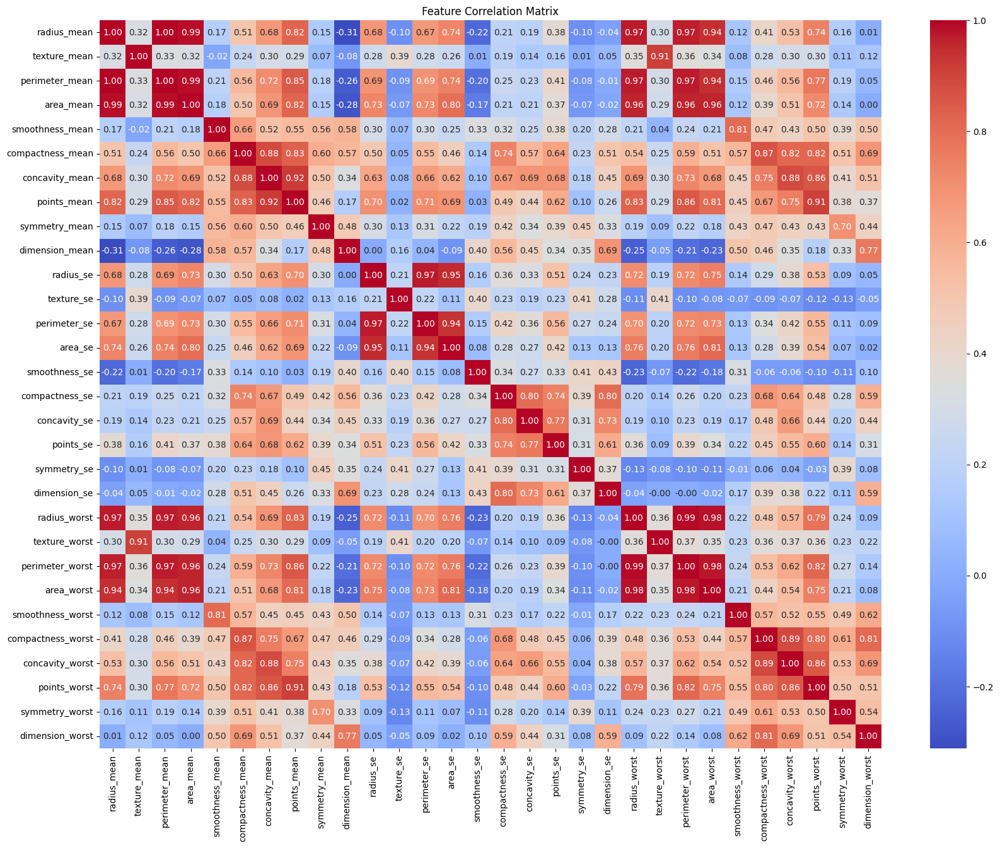

In [10]:
# Visualize correlations using a heatmap
plt.figure(figsize=(20, 15))
# Drop 'diagnosis' column for correlation matrix
bc_corr = bc_df.drop(columns='diagnosis').corr()
sns.heatmap(bc_corr, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Feature Correlation Matrix")
plt.show()

In [11]:
# Pairplot for visualizing relationships between features
sns.pairplot(bc_df, hue='diagnosis', diag_kind='kde')
plt.show()

In [12]:
# Feature scaling using z-score normalization
bc_feature_df = bc_df.drop(columns='diagnosis')
bc_feature_df_z = bc_feature_df.apply(zscore)
print("Features after Z-score normalization:\n", bc_feature_df_z.describe().transpose())

Features after Z-score normalization:
                    count          mean      std       min       25%       50%  \
radius_mean        569.0 -1.576556e-16  1.00088 -2.029648 -0.689385 -0.215082   
texture_mean       569.0 -7.711075e-16  1.00088 -2.229249 -0.725963 -0.104636   
perimeter_mean     569.0 -1.186319e-16  1.00088 -1.984504 -0.691956 -0.235980   
area_mean          569.0 -2.029230e-16  1.00088 -1.454443 -0.667195 -0.295187   
smoothness_mean    569.0  1.717041e-16  1.00088 -3.112085 -0.710963 -0.034891   
compactness_mean   569.0  1.935573e-16  1.00088 -1.610136 -0.747086 -0.221940   
concavity_mean     569.0  4.058460e-17  1.00088 -1.114873 -0.743748 -0.342240   
points_mean        569.0 -5.619407e-17  1.00088 -1.261820 -0.737944 -0.397721   
symmetry_mean      569.0  1.638994e-16  1.00088 -2.744117 -0.703240 -0.071627   
dimension_mean     569.0 -1.492265e-15  1.00088 -1.819865 -0.722639 -0.178279   
radius_se          569.0  2.247763e-16  1.00088 -1.059924 -0.623571 -0

In [13]:
# Separate the labels
bc_labels = bc_df['diagnosis']

In [14]:
# Store features and labels into numpy arrays
X = np.array(bc_feature_df_z)
y = np.array(bc_labels)

In [15]:
# Split data into training and testing sets (70:30 ratio)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1)

# KNN Classifier training & Evaluation

In [16]:
# Initialize and train the KNN classifier
NNH = KNeighborsClassifier(n_neighbors=5, weights='distance')
NNH.fit(X_train, y_train)

KNeighborsClassifier(weights='distance')

In [17]:
# For every test data point, predict its label based on 5 nearest neighbors in this model. The majority class will be assigned to the test data point
# Predict the labels for the test set
predicted_labels = NNH.predict(X_test)

# Evaluate the model
accuracy = NNH.score(X_test, y_test)
conf_matrix = metrics.confusion_matrix(y_test, predicted_labels)

print("Confusion Matrix:\n", conf_matrix)
print("Accuracy Score:", accuracy)

Confusion Matrix:
 [[112   2]
 [  4  53]]
Accuracy Score: 0.9649122807017544


# Iteration 2: Dropping highly correlated feature 'radius_mean'
As is evident from the scatter matrix, many dimensions have strong correlation and that is not surprising
Area and Perimeter are functions of radius, so they will have strong correlation. Why take multiple dimensions
when they convey the same information to the model?

In [18]:
# Iteration 2: Dropping highly correlated feature 'radius_mean'
bc_features_pruned_df_z = bc_feature_df_z.drop(columns=['radius_mean'])

X_pruned = np.array(bc_features_pruned_df_z)

In [19]:
# Split the pruned data into training and testing sets
X_train_pruned, X_test_pruned, y_train_pruned, y_test_pruned = train_test_split(X_pruned, y, test_size=0.30, random_state=1)

In [20]:
# Train the KNN classifier on pruned data
NNH.fit(X_train_pruned, y_train_pruned)

KNeighborsClassifier(weights='distance')

In [21]:
# For every test data point, predict its label based on 5 nearest neighbors in this model. The majority class will be assigned to the test data point
# Predict the labels for the pruned test set
predicted_labels_pruned = NNH.predict(X_test_pruned)

# Evaluate the pruned model
accuracy_pruned = NNH.score(X_test_pruned, y_test_pruned)
conf_matrix_pruned = metrics.confusion_matrix(y_test_pruned, predicted_labels_pruned)

print("Confusion Matrix after Pruning:\n", conf_matrix_pruned)
print("Accuracy Score after Pruning:", accuracy_pruned)

Confusion Matrix after Pruning:
 [[112   2]
 [  4  53]]
Accuracy Score after Pruning: 0.9649122807017544


In [22]:
# Visual comparison of results
print("Initial Accuracy Score:", accuracy)
print("Pruned Accuracy Score:", accuracy_pruned)

Initial Accuracy Score: 0.9649122807017544
Pruned Accuracy Score: 0.9649122807017544
